# Metric comparison with expert asessment
## Dataset 1

Metric compuation procedure is described in [Metric for evaluating difference between seismograms](./Metrics_study_intro.ipynb)

In [1]:
import sys
sys.path.append('..')

import pandas as pd

from functools import reduce

from seismicpro.batchflow import Dataset
from seismicpro.src import SeismicBatch, FieldIndex

from utils import get_cv, draw_modifications_dist, validate_all, get_modifications_list

## Loading data

In [2]:
base_path = '/data/Metrix_QC/' 
      
paths = {
    'lift': '2_QC_Metrix-4.sgy', 
    'raw': '2_QC_Metrix_1.sgy',
    'm_1': '2_QC_Metrix-2.sgy',
    'm_2': '2_QC_Metrix-3.sgy',
    'm_3': '2_QC_Metrix-5.sgy',
}

field_index = reduce(lambda x, y: x.merge(y), 
                     (FieldIndex(name=name, path=base_path+path, extra_headers=['offset']) for name, path in paths.items()))


batch = (Dataset(field_index, SeismicBatch)
         .next_batch(len(field_index))
         .load(fmt='segy', components=tuple(paths.keys())))

cv = get_cv([batch.__getattr__(c)[0] for c in batch.components])

print("Number of fields: {}".format(len(field_index)))

Number of fields: 10


## Metrics calculation with lift as base

On all fields expert rate M_1 as the worst model and M_3 as the best one

In [3]:
res = validate_all(batch)
df = pd.DataFrame(res)
df["agrees with experts amplitude"] = (df.M_1_amp > df.M_2_amp) & (df.M_2_amp > df.M_3_amp)
df["agrees with experts phase"] = (df.M_1_ph > df.M_2_ph) & (df.M_2_ph > df.M_3_ph)
df

,LIFT_amp,LIFT_ph,M_1_amp,M_1_ph,M_2_amp,M_2_ph,M_3_amp,M_3_ph,RAW_amp,RAW_ph,agrees with experts amplitude,agrees with experts phase
0,0.0,0.0,8.522570,75.008392,3.062865,64.323273,0.481211,68.070053,21.985258,44.071194,True,False
1,0.0,0.0,51.447529,74.081932,18.819611,63.465313,0.507882,74.830177,23.780172,40.471703,True,False
2,0.0,0.0,12.296423,74.298874,5.142989,63.419178,0.458328,71.879997,27.622038,43.440273,True,False
3,0.0,0.0,39.901947,75.137177,16.470945,65.048019,0.496259,72.555405,31.871132,42.027912,True,False
4,0.0,0.0,23.658798,77.253578,10.488453,66.636398,0.980444,78.527039,77.803833,43.568134,True,False
5,0.0,0.0,27.463614,76.103188,10.752850,64.942650,0.707495,71.394005,48.293118,43.342827,True,False
6,0.0,0.0,33.501827,78.695946,11.133759,68.724213,0.743768,79.403763,56.002003,44.827690,True,False
7,0.0,0.0,27.378849,74.523659,10.694746,62.341805,0.704905,73.799606,28.501654,42.273232,True,False
8,0.0,0.0,50.918888,74.407005,25.064690,62.849606,0.706658,72.787857,21.854462,39.771149,True,False
9,0.0,0.0,27.708401,77.205254,9.610407,66.704384,0.748706,78.394485,39.059879,43.915421,True,False


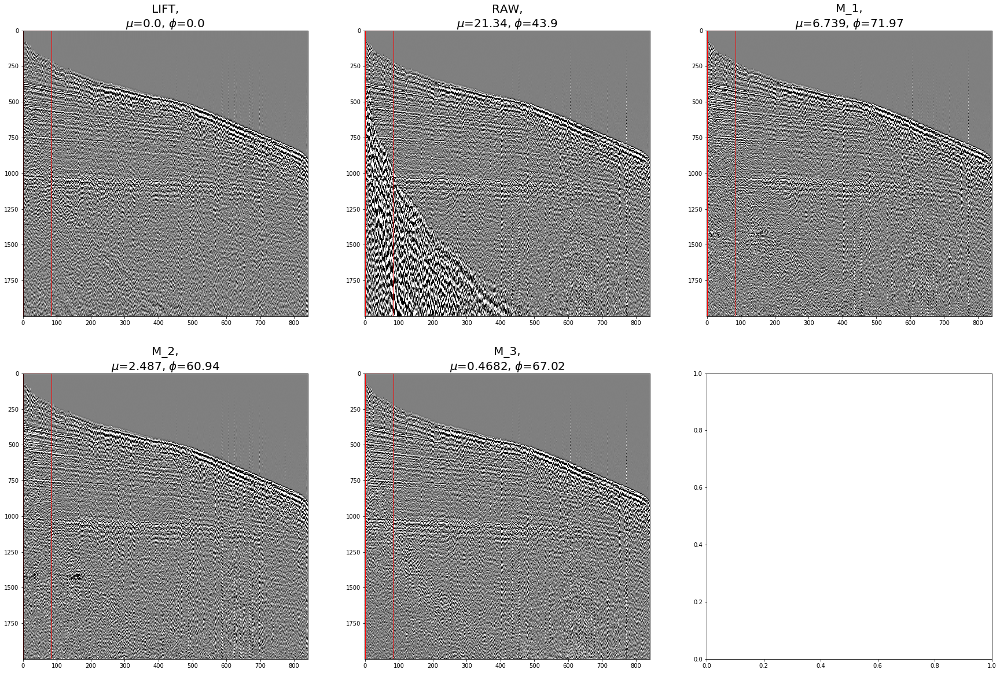

In [4]:
i=0
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

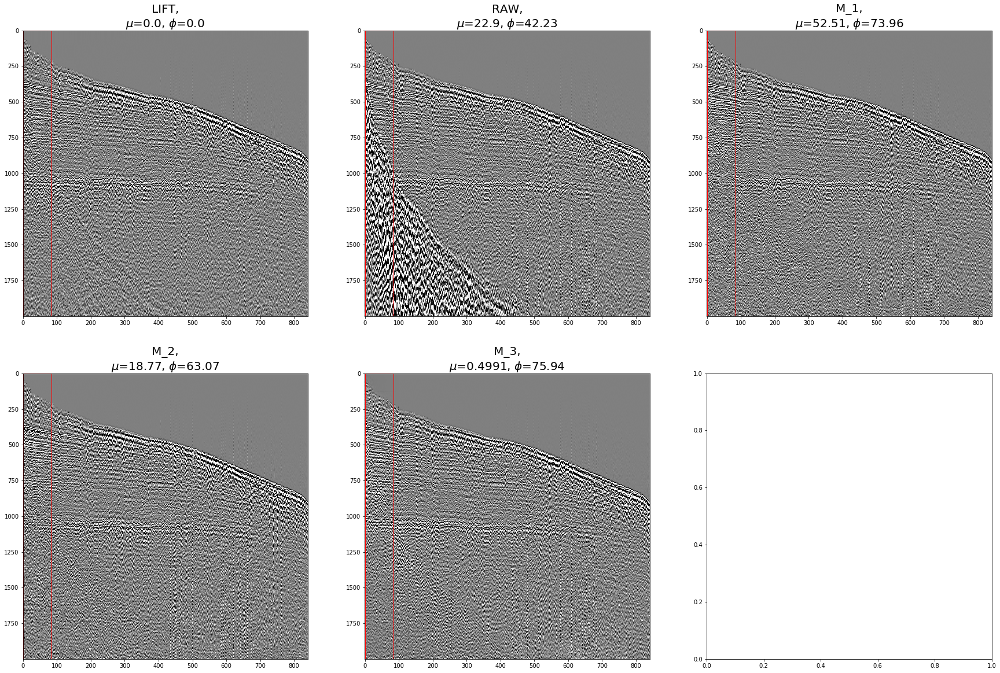

In [5]:
i=1
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

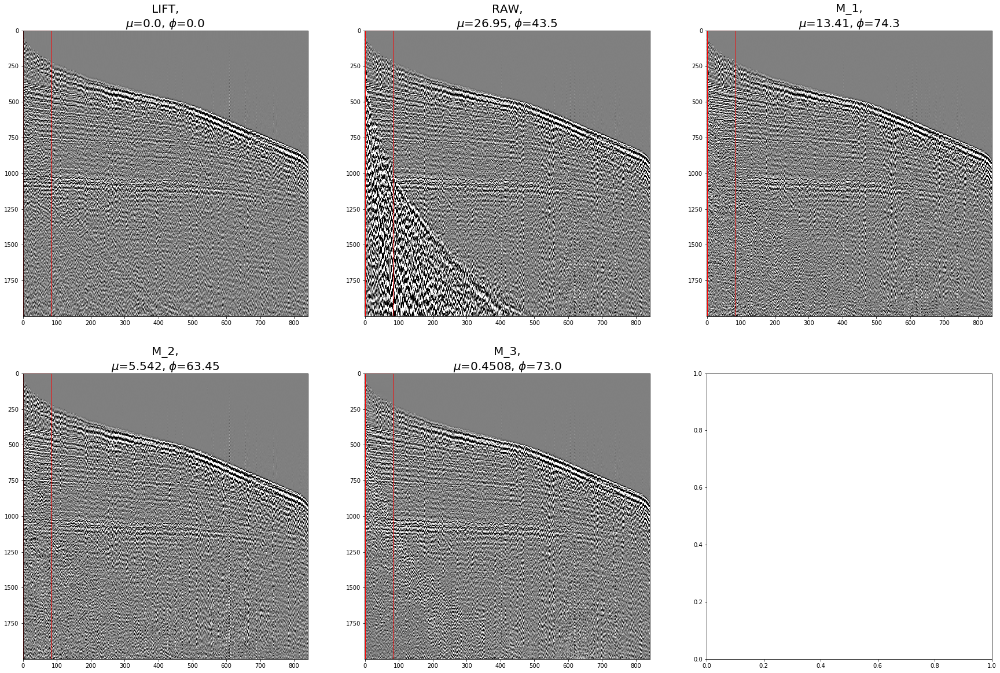

In [6]:
i=2
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

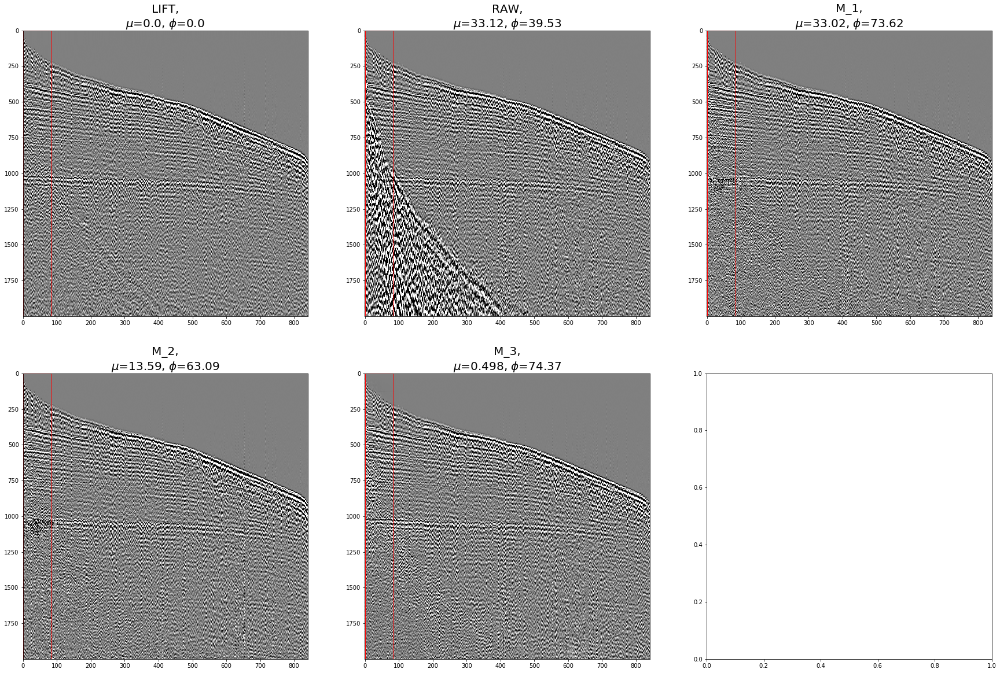

In [7]:
i=3
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

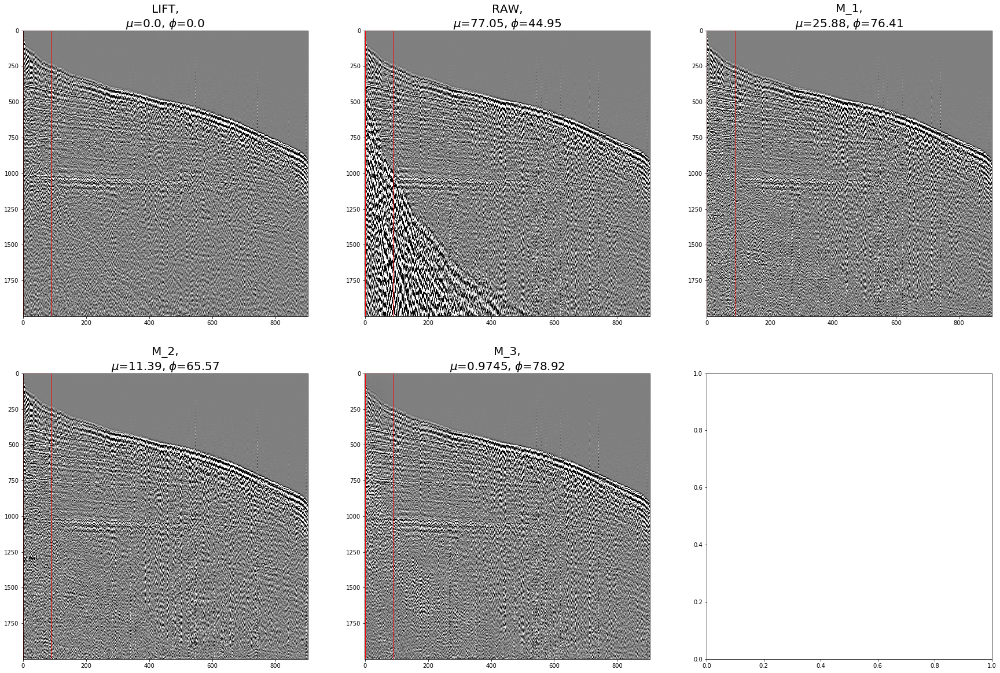

In [8]:
i=4
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

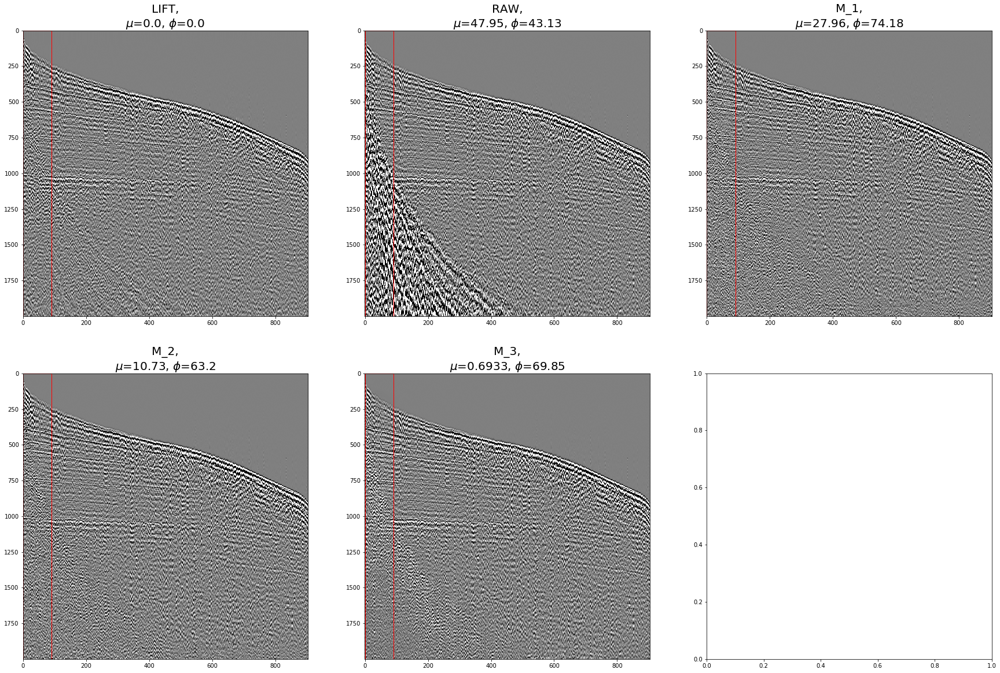

In [9]:
i=5
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

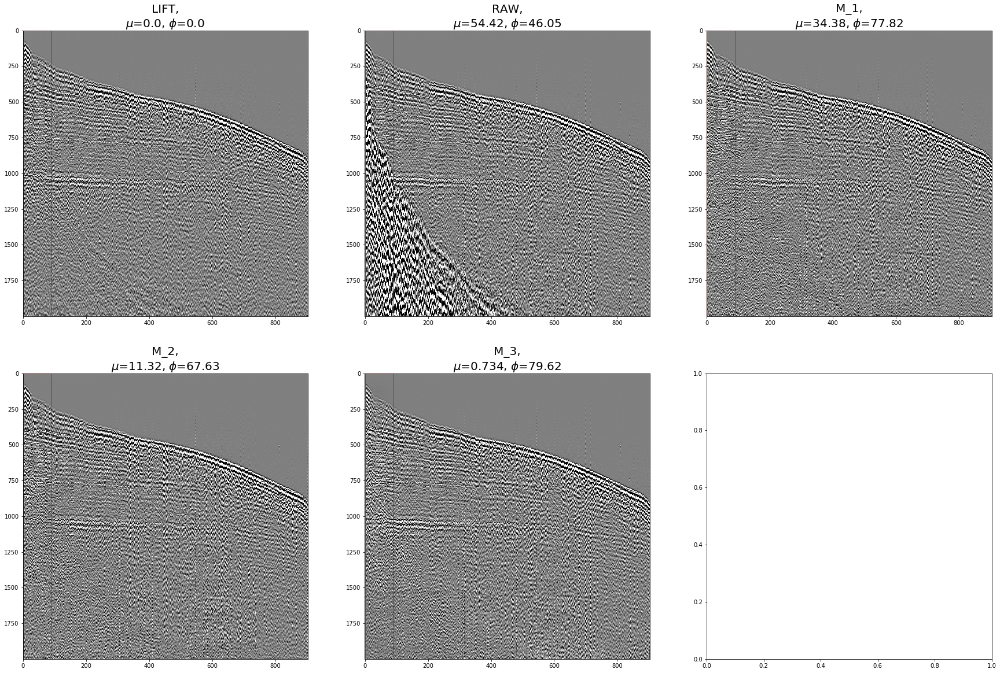

In [10]:
i=6
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

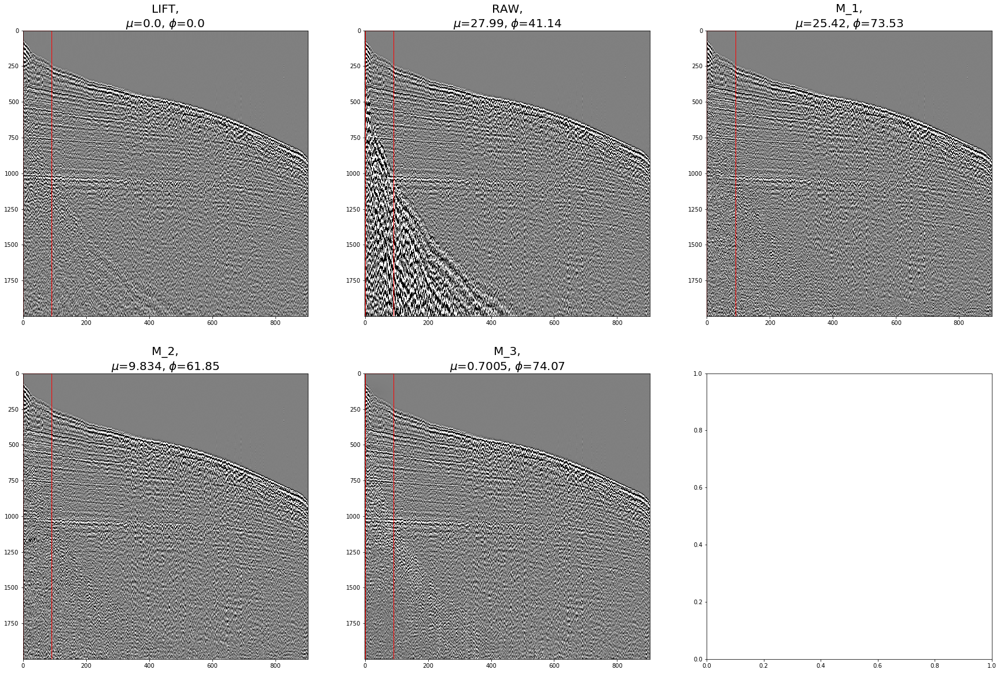

In [11]:
i=7
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

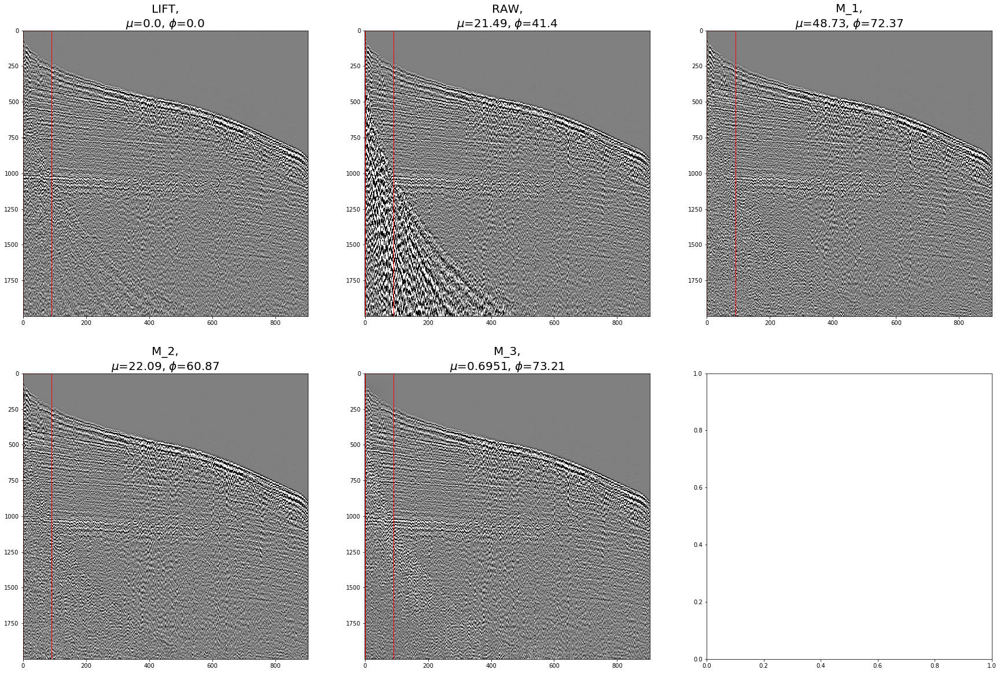

In [12]:
i=8
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

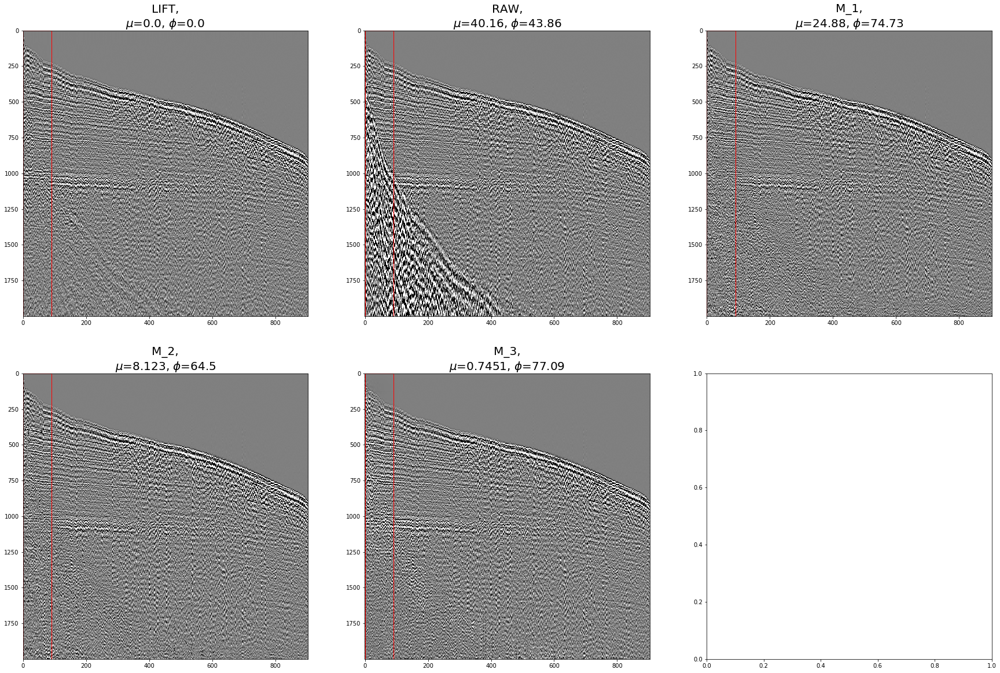

In [13]:
i=9
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')